THIS NOTEBOOK CONTAINS MY EDA AND VISUALIZATIONS FOR THE PROJECT

In [24]:
#import necessary packages and modules
import math
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', 300)
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_style('darkgrid')

In [25]:
#all our independent variables
result=pd.read_csv('Tanzania.csv')
result.columns

Index(['id', 'amount_tsh', 'date_recorded', 'funder', 'gps_height',
       'installer', 'longitude', 'latitude', 'wpt_name', 'num_private',
       'basin', 'subvillage', 'region', 'region_code', 'district_code', 'lga',
       'ward', 'population', 'public_meeting', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'construction_year',
       'extraction_type', 'extraction_type_group', 'extraction_type_class',
       'management', 'management_group', 'payment', 'payment_type',
       'water_quality', 'quality_group', 'quantity', 'quantity_group',
       'source', 'source_type', 'source_class', 'waterpoint_type',
       'waterpoint_type_group'],
      dtype='object')

In [26]:
#dependent variable
df1=pd.read_csv('Tanzania1.csv')
df1.columns

Index(['id', 'status_group'], dtype='object')

In [27]:
#changing our categorical variable to a number
df1['status_group']= df1['status_group'].map({'functional':2, 'functional needs repair':1,
                            'non functional':0})

In [28]:
#data cleaning to get the age of the well
result['Age']= result['construction_year'].replace(0, 2000)

In [29]:
#look at our dataset columns
result.columns

Index(['id', 'amount_tsh', 'date_recorded', 'funder', 'gps_height',
       'installer', 'longitude', 'latitude', 'wpt_name', 'num_private',
       'basin', 'subvillage', 'region', 'region_code', 'district_code', 'lga',
       'ward', 'population', 'public_meeting', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'construction_year',
       'extraction_type', 'extraction_type_group', 'extraction_type_class',
       'management', 'management_group', 'payment', 'payment_type',
       'water_quality', 'quality_group', 'quantity', 'quantity_group',
       'source', 'source_type', 'source_class', 'waterpoint_type',
       'waterpoint_type_group', 'Age'],
      dtype='object')

In [30]:
#data cleaning to get teh age of the well right
result['Age']=(2020-result['Age'])

In [31]:
#looking at our values for age and getting ready to plot histogram
result['Age'].value_counts()

20    22800
10     2645
12     2613
11     2533
13     1587
14     1471
17     1286
9      1256
16     1123
8      1084
18     1075
42     1037
25     1014
15     1011
21      979
22      966
30      954
35      945
40      811
24      811
36      779
38      744
26      738
48      708
46      676
23      644
28      640
27      608
19      540
32      521
37      488
45      437
34      434
44      414
50      411
29      324
31      316
33      302
39      238
43      202
41      192
47      184
7       176
49      145
60      102
53       88
57       85
52       77
51       59
56       40
58       30
59       21
55       19
54       17
Name: Age, dtype: int64

In [32]:
#concatenating teh independent and dependent variable dataframe for EDA
modelFrame = pd.concat([df1,result], axis=1)

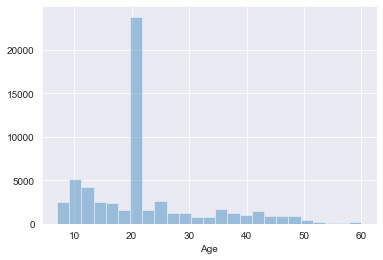

In [33]:
# result['Age']= df3.iloc[0:32259] + df3.iloc[32259:36576] + df3.iloc[36576: ]
sns.distplot(result['Age'], bins=25, kde=False)
#histogram of age

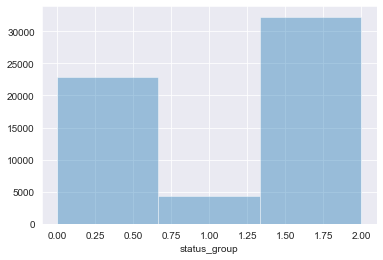

In [34]:
#histogram showing the three different functionalities of the wells (functional, non functional and 
#needs repair
sns.distplot(df1['status_group'],bins=3, kde=False)


In [35]:
#cleaning up data to find the age of the well
modelFrame['Age']= modelFrame['construction_year'].replace(0, 2000)

In [36]:
#cleaning up data to find the age of the well
modelFrame['Age']=(2020-modelFrame['Age'])

(11, 11)

In [37]:
#a groupby to check the age and functional status of data, hoping to bring new insight into data
modelFrame.groupby('Age').apply(lambda x:x.sort_values 
                                         (by=['status_group'], ascending=False))

id  status_group     id  amount_tsh date_recorded  \
Age                                                               
7   21139  18481             2  18481        50.0    2013-02-07   
    52200  31511             2  31511         0.0    2013-03-25   
    47912  50118             2  50118         0.0    2013-12-03   
    29223  44338             2  44338         0.0    2013-12-03   
    47971  54214             2  54214         0.0    2013-02-15   
...          ...           ...    ...         ...           ...   
60  19765  50138             0  50138         0.0    2011-03-11   
    19057   3002             0   3002         0.0    2013-03-29   
    18543  64714             0  64714         0.0    2013-01-14   
    17826  33489             0  33489         0.0    2013-01-20   
    58586  22187             0  22187         0.0    2013-01-22   

                           funder  gps_height                   installer  \
Age                                                                         
7   21139                     Lga         361                         LGA   
    52200          Oikos E.Afrika        1442              Oikos E.Africa   
    47912       Save The Rain Usa        1321           Save the rain USA   
    29223        Summit For Water        1194  Summit for water/Community   
    47971                    Undp         474                  Government   
...                           ...         ...                         ...   
60  19765      Private Individual          23           Amboni Plantation   
    19057  Government Of Tanzania        1636          Central Government   
    18543                     NaN        1575                         NaN   
    17826                     NaN        1419                         NaN   
    58586                     NaN        1485                         NaN   

           longitude   latitude                  wpt_name  num_private  \
Age                                                                      
7   21139  39.258468 -10.999233                    Twalib            0   
    52200  36.912262  -3.250556  Nkoasenga Primary School            0   
    47912  36.803141  -3.351783       Poli Primary School            0   
    29223  36.832678  -3.385455      Uraki Primary School            0   
    47971  34.948171 -11.459013            Kwa Mzee Ndozi            0   
...              ...        ...                       ...          ...   
60  19765  38.883474  -5.615303                  Mabatini           41   
    19057  37.583047  -3.262020              Kwa Mamchoni            0   
    18543  35.023680  -4.537133                    Polisi            0   
    17826  34.666392  -4.653909                  Ramadhan            0   
    58586  34.530408  -4.756078             Simioni Sungi            0   

                             basin    subvillage       region  region_code  \
Age                                                                          
7   21139  Ruvuma / Southern Coast         Zaire       Mtwara           90   
    52200                  Pangani       Bwawani       Arusha            2   
    47912                  Pangani         Ntuwe       Arusha            2   
    29223                  Pangani     Kilalanic       Arusha            2   
    47971               Lake Nyasa  Ng'Ombo Kati       Ruvuma           10   
...                            ...           ...          ...          ...   
60  19765                  Pangani        Estate        Tanga            4   
    19057                  Pangani  Maring'A Juu  Kilimanjaro            3   
    18543                 Internal      Mara Iku      Singida           13   
    17826                 Internal  Barabara Kuu      Singida           13   
    58586                 Internal      Madukani      Singida           13   

           district_code            lga          ward  population  \
Age                                                                 
7   21139             33

In [38]:
#a groupby of functionality status of the wells along with the 'well type' (extraction_type)
modelFrame.groupby('status_group').apply(lambda x:x.sort_values 
                                         (by=['extraction_type_class'], ascending=False))

id  status_group     id  amount_tsh date_recorded  \
status_group                                                               
0            23207  67146             0  67146         0.0    2013-02-05   
             56555  42653             0  42653         0.0    2011-04-01   
             29856  72472             0  72472        20.0    2013-01-20   
             20796  32014             0  32014         0.0    2012-10-07   
             31111  35786             0  35786        20.0    2011-03-05   
...                   ...           ...    ...         ...           ...   
2            36254  31448             2  31448         0.0    2011-02-20   
             36255  23420             2  23420         0.0    2011-03-30   
             36257  11904             2  11904         0.0    2013-03-22   
             36262  28614             2  28614         0.0    2013-03-24   
             0      69572             2  69572      6000.0    2011-03-14   

                                     funder  gps_height             installer  \
status_group                                                                    
0            23207                      NaN        1383                   NaN   
             56555                    Tirdo           0                   TWE   
             29856                     Dfid        1549             WATER AID   
             20796                    Tasaf           0             Community   
             31111                    Donor         -37                    Do   
...                                     ...         ...                   ...   
2            36254                     Cdtf        1373                  CDTF   
             36255                 Irish Ai         261                   DWE   
             36257                      Wfp        1642                   NaN   
             36262  Magadini-makiwaru Water        1249  Magadini-Makiwaru wa   
             0                        Roman        1390                 Roman   

                    longitude  latitude             wpt_name  num_private  \
status_group                                                                
0            23207  34.762769 -5.491480             Serikali            0   
             56555  38.482895 -5.109173              Ofisini            0   
             29856  34.793811 -4.843347              Kidinku            0   
             20796  34.208341 -3.858462            Mwamanoni            0   
             31111  38.776445 -6.040560   Saadani Dispensary            0   
...                       ...       ...                  ...          ...   
2            36254  34.619479 -9.972039                 none            0   
             36255  36.920551 -7.770258           Kwamakwala            0   
             36257  36.527560 -2.845362              Shuleni            0   
             36262  37.037561 -3.201209  Kwa Joackim Marandu            0   
             0      34.938093 -9.856322                 none            0   

                          basin    subvillage       region  region_code  \
status_group                                                              
0            23207     Internal       Choda A      Singida           13   
             56555      Pangani      Muembeni        Tanga            4   
             29856     Internal     Mungumaji      Singida           13   
             20796     Internal        Kisesa    Shinyanga           17   
             31111  Wami / Ruvu        Bomani        Pwani            6   
...                         ...           ...          ...          ...   
2            36254   Lake Nyasa    Mkwegidoto       Iringa           11   
             36255       Rufiji       Shuleni     Morogoro            5   
             36257     Internal    Ing'Oswani       Arusha            2   
             36262      Pangani  Majengo Kati  Kilimanjaro            3   
             0       Lake Nyasa      Mnyusi B       Iringa           11   

  

In [39]:
#renaming dataframe
df2=modelFrame

In [40]:
#sorting through dataframe and breaking up the functionality status of the wells for analysis
df3=df2.sort_values(['status_group'],ascending=False)

In [41]:
#getting the indexes of our 3 groups
df3['status_group'].value_counts()

2    32259
0    22824
1     4317
Name: status_group, dtype: int64

In [42]:
#Functional group
functional=df3.iloc[0:32259]

In [43]:
#needs repair group
needs_repair=df3.iloc[32259:36576]

In [44]:
#Non functional group
non_functional=df3.iloc[36576: ]

In [45]:
result.columns

Index(['id', 'amount_tsh', 'date_recorded', 'funder', 'gps_height',
       'installer', 'longitude', 'latitude', 'wpt_name', 'num_private',
       'basin', 'subvillage', 'region', 'region_code', 'district_code', 'lga',
       'ward', 'population', 'public_meeting', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'construction_year',
       'extraction_type', 'extraction_type_group', 'extraction_type_class',
       'management', 'management_group', 'payment', 'payment_type',
       'water_quality', 'quality_group', 'quantity', 'quantity_group',
       'source', 'source_type', 'source_class', 'waterpoint_type',
       'waterpoint_type_group', 'Age'],
      dtype='object')

In [46]:
#cleaning the categorical data 
result['permit'].map({True:1, False:2, np.nan: 0})

0        2
1        1
2        1
3        1
4        1
        ..
59395    1
59396    1
59397    2
59398    1
59399    1
Name: permit, Length: 59400, dtype: int64

In [47]:
#a count to see if having a permit makes the well more well-kept
functional['permit'].value_counts()

True     21541
False     9045
Name: permit, dtype: int64

In [48]:
#a count to see if having a permit makes the well more well-kept
needs_repair['permit'].value_counts()

True     2697
False    1320
Name: permit, dtype: int64

In [49]:
#a count to see if having a permit makes the well more well-kept
non_functional['permit'].value_counts()

True     14614
False     7127
Name: permit, dtype: int64

In [50]:
#finds the pump type of all functional wells
functional['extraction_type_class'].value_counts()

gravity         16048
handpump        10375
submersible      3329
motorpump        1135
other            1029
rope pump         293
wind-powered       50
Name: extraction_type_class, dtype: int64

In [51]:
#EDA to see the regions of the country with respect to the functionality of the wells
functional['region'].value_counts()

Iringa           4141
Shinyanga        2789
Kilimanjaro      2640
Mbeya            2319
Arusha           2294
Morogoro         2119
Kagera           1727
Pwani            1556
Mwanza           1502
Ruvuma           1480
Tanga            1436
Kigoma           1363
Singida          1011
Dodoma           1009
Manyara           987
Mara              886
Tabora            848
Rukwa             707
Mtwara            524
Dar es Salaam     461
Lindi             460
Name: region, dtype: int64

In [52]:
functional['funder'].value_counts()

Government Of Tanzania    3720
Danida                    1713
Hesawa                     936
Rwssp                      805
World Vision               743
                          ... 
Peter Mayiro                 1
Kwa Mzee Waziri              1
Nyeisa                       1
Rwsso                        1
Daldo                        1
Name: funder, Length: 1421, dtype: int64

In [53]:
#of the wells that worked what was their water quality
functional['water_quality']= functional['water_quality'].map({ 'soft': 'soft', 'salty':'salty', 'flouride':'flouride', 'unknown': 'unpotable', 'milky':'unpotable',
                            'coloured': 'unpotable', 'salty abandoned': 'unpotable', np.nan:'unpotable' })
functional['water_quality'].value_counts()


/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


soft         28760
salty         2220
unpotable     1122
Name: water_quality, dtype: int64

In [54]:
#which wells needed repair and had bad water
needs_repair['water_quality']= needs_repair['water_quality'].map({ 'soft': 'soft', 'salty':'salty', 'flouride':'flouride', 'unknown': 'unpotable', 'milky':'unpotable',
                            'coloured': 'unpotable', 'salty abandoned': 'unpotable', np.nan:'unpotable' })
needs_repair['water_quality'].value_counts()

/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


soft         3904
salty         225
unpotable     175
Name: water_quality, dtype: int64

In [55]:
#which wells were potable but non_functional
non_functional['water_quality']= non_functional['water_quality'].map({ 'soft': 'soft', 'salty':'salty', 'flouride':'flouride', 'unknown': 'unpotable', 'milky':'unpotable',
                            'coloured': 'unpotable', 'salty abandoned': 'unpotable', np.nan:'unpotable' })
non_functional['water_quality'].value_counts()

/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


soft         18154
salty         2411
unpotable     2212
Name: water_quality, dtype: int64

In [56]:
#finds the pump type of all need repairs wells
needs_repair['extraction_type_class'].value_counts()

gravity         2701
handpump         995
submersible      253
other            206
motorpump        138
rope pump         17
wind-powered       7
Name: extraction_type_class, dtype: int64

In [57]:
#more EDA too see if certain regions were neglected in well functionality 
needs_repair['region'].value_counts()

Shinyanga        635
Kigoma           603
Mbeya            504
Kilimanjaro      322
Kagera           304
Morogoro         300
Dodoma           209
Mwanza           183
Arusha           175
Ruvuma           164
Rukwa            135
Singida          128
Mtwara           126
Iringa           123
Manyara           96
Lindi             93
Tanga             73
Mara              60
Tabora            45
Pwani             36
Dar es Salaam      3
Name: region, dtype: int64

In [58]:
#found no signifigance in funder and well maintenance
needs_repair['funder'].value_counts()

Government Of Tanzania    701
Hesawa                    232
Dwsp                      225
Norad                     165
Danida                    159
                         ... 
Kilomber                    1
Sw                          1
Conce                       1
Roman Catholic              1
Usaid/wfp                   1
Name: funder, Length: 367, dtype: int64

In [59]:
#finds the pump type of all of non functional wells
non_functional['extraction_type_class'].value_counts()


gravity         8031
other           5195
handpump        5086
submersible     2597
motorpump       1714
rope pump        141
wind-powered      60
Name: extraction_type_class, dtype: int64

In [60]:
#EDA tells us which regions have the most broken wells 
non_functional['region'].value_counts()

Mbeya            1816
Morogoro         1587
Shinyanga        1558
Kilimanjaro      1417
Mwanza           1417
Kagera           1285
Mtwara           1080
Tabora           1066
Pwani            1043
Tanga            1038
Iringa           1030
Mara             1023
Ruvuma            996
Lindi             993
Dodoma            983
Rukwa             966
Singida           954
Arusha            881
Kigoma            850
Manyara           500
Dar es Salaam     341
Name: region, dtype: int64

In [61]:
#found no signifigant difference in funder and well maintenance
non_functional['funder'].value_counts()

Government Of Tanzania       4663
Danida                       1242
Hesawa                       1034
World Bank                    707
Kkkt                          498
                             ... 
Oldadai Village Community       1
C                               1
Cpro                            1
Rdws                            1
Omar Ally                       1
Name: funder, Length: 1019, dtype: int64

In [62]:
#EDA on if age affects the maintenance needs of the well
functional['Age'].mean()

20.0412598034657

In [63]:
#EDA on if age affects the maintenance needs of the well
non_functional['Age'].mean()

24.8161584297231

In [64]:
#EDA on if age affects the maintenance needs of the well
needs_repair['Age'].mean()

22.776928422515635

In [65]:
# EDA on supply of water in Tanzania wells
functional['quantity'].value_counts()

enough          21648
insufficient     7916
seasonal         2325
unknown           213
dry               157
Name: quantity, dtype: int64

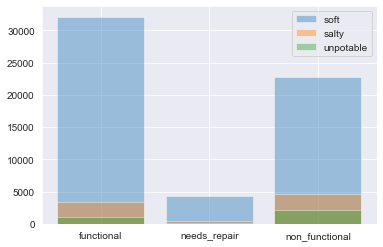

In [66]:
kwargs=dict(alpha=0.40)
plt.bar(x=['functional', 'needs_repair', 'non_functional'], 
        height= [32102,4304,22777],label='soft', **kwargs)
plt.bar(x=['functional', 'needs_repair', 'non_functional'], 
        height= [3342, 400, 4623], label= 'salty',**kwargs)
plt.bar(x=['functional', 'needs_repair', 'non_functional'], 
        height= [1122, 175, 2212],label= 'unpotable',**kwargs)
figsize=(35,10)
plt.legend()

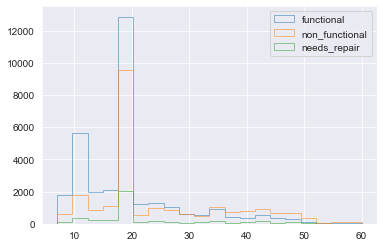

In [67]:
#Viz 2 shows age of well with respect to functionality
kwargs=dict(histtype='step', alpha=.5, bins=20)
plt.hist(functional['Age'],  label='functional',**kwargs)
plt.hist(non_functional['Age'], label= 'non_functional',**kwargs)
plt.hist(needs_repair['Age'],label= 'needs_repair',**kwargs);
plt.legend()

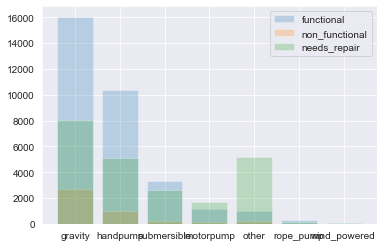

In [146]:
#Viz 3 to show which pump types had the most breakdowns
kwargs=dict(alpha=0.25)
plt.bar(x=['gravity', 'handpump', 'submersible', 'motorpump' ,'other', 'rope_pump', 'wind_powered'], 
        height= [16048,10375,3329, 1135, 1029, 293, 50],label='functional', **kwargs)
plt.bar(x=['gravity', 'handpump', 'submersible', 'motorpump', 'other', 'rope_pump', 'wind_powered'], 
        height= [2701, 995, 253, 138, 206,17, 7], label= 'non_functional',**kwargs)
plt.bar(x=['gravity', 'handpump', 'submersible', 'motorpump', 'other', 'rope_pump', 'wind_powered'], 
        height= [8031, 5086, 2597, 1714, 5195, 141, 60],label= 'needs_repair',**kwargs)
figsize=(1000,10)
plt.legend()

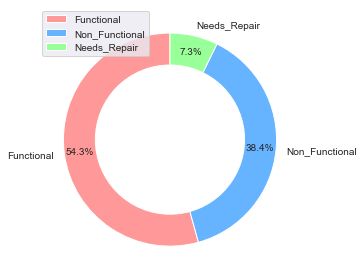

In [247]:
#pie graph to show distribution of well functionality
import matplotlib.pyplot as plt
%matplotlib inline
# Pie chart
labels = ['Functional', 'Non_Functional', 'Needs_Repair']
sizes = [32259, 22824, 4317]
#colors
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99']
 
plt.pie(sizes, colors = colors, labels=labels, autopct='%1.1f%%', startangle=90, pctdistance=0.85)
#draw circle
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
# Equal aspect ratio ensures that pie is drawn as a circle
plt.legend() 
plt.tight_layout()
plt.show()

In [81]:
#folium to map geospatial heatmap for our well locations
import folium
from folium import plugins

In [104]:
m

In [103]:
m= folium.Map(
    location=[-6.8, 35.3556],
    zoom_start=6)




In [4]:
result=pd.read_csv('Tanzania.csv')
result.columns

Index(['id', 'amount_tsh', 'date_recorded', 'funder', 'gps_height',
       'installer', 'longitude', 'latitude', 'wpt_name', 'num_private',
       'basin', 'subvillage', 'region', 'region_code', 'district_code', 'lga',
       'ward', 'population', 'public_meeting', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'construction_year',
       'extraction_type', 'extraction_type_group', 'extraction_type_class',
       'management', 'management_group', 'payment', 'payment_type',
       'water_quality', 'quality_group', 'quantity', 'quantity_group',
       'source', 'source_type', 'source_class', 'waterpoint_type',
       'waterpoint_type_group'],
      dtype='object')

In [94]:
#coding for our geospatial data points
stationArr = non_functional[['latitude', 'longitude']].as_matrix()

/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.


In [141]:
#heatmap for our wells that are non_functional
m.add_children(plugins.HeatMap(stationArr, min_opacity=10, blur=1, radius=15))
m

/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Method `add_children` is deprecated. Please use `add_child` instead.
  """Entry point for launching an IPython kernel.


In [142]:
#heatmap of wells that need repair
stationArr1 = needs_repair[['latitude', 'longitude']].as_matrix()
ma.add_children(plugins.HeatMap(stationArr, min_opacity=10, blur=1, radius=15))
ma      
          

/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.
/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: Method `add_children` is deprecated. Please use `add_child` instead.
  


In [116]:
ma1 = folium.Map(location=[-6.8, 35.3556],
               zoom_start=6)


In [143]:
#heatmap of all wells in the country
stationArr1 = result[['latitude', 'longitude']].as_matrix()
ma1.add_children(plugins.HeatMap(stationArr, min_opacity=10 ,blur=1, radius=15))
ma1      

/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Method .as_matrix will be removed in a future version. Use .values instead.
  """Entry point for launching an IPython kernel.
/Users/jeffreyng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: FutureWarning: Method `add_children` is deprecated. Please use `add_child` instead.
  


In [18]:
#code that can iterate thru all our well points (lat, long) and plot on map
import numpy as np

locations = result[['latitude', 'longitude']]
locationlist = locations.values.tolist()
len(locationlist)
locationlist[7]






[-4.22619802, 32.62061707]

In [19]:

for x in range(0, 250):
    folium.Marker(locationlist[x], icon=folium.Icon(icon='red')).add_to(m)

    

In [89]:
folium.Marker(
        location=[-5.85632177, 35.86131531],
        icon=folium.Icon(icon='red')).add_to(m)

In [91]:
#test point marker
folium.Marker(locationlist[7], icon=folium.Icon(icon='red')).add_to(m)